#Auditory System

Machens, C. K., Wehr, M. S., & Zador, A. M. (2004). Linearity of Cortical Receptive Fields Measured with Natural Sounds. Journal of Neuroscience, 24(5), 1089–1100. https://doi.org/10.1523/JNEUROSCI.4445-03.2004

In [12]:
import pickle
import IPython
from IPython.display import YouTubeVideo
import numpy as np
import pandas as pd
import scipy.io.wavfile as wavfile
from scipy.signal import spectrogram, welch, find_peaks, butter, lfilter
import matplotlib.pyplot as plt

In [ ]:
YouTubeVideo('VRAXK4QKJ1Q', width='900', height='500')

In [14]:
records = pd.read_pickle('https://raw.githubusercontent.com/regevti/sensory-systems-workshop/master/Auditory/records.pkl')
trig_df = pd.read_pickle('https://raw.githubusercontent.com/regevti/sensory-systems-workshop/master/Auditory/trig_df.pkl')
trig_df.head()

,index,file,type,time,ramp,duration,description,sf,name,frequency,amplitude,date,animal,penetNo,recNo
0,0,NaN,tone,1000.0,5.0,25.0,NaN,NaN,20020604-mw-001-001,4000.000,60.0,20020604,mw,001,001
1,1,NaN,tone,4200.0,5.0,25.0,NaN,NaN,20020604-mw-001-001,20158.740,60.0,20020604,mw,001,001
2,2,NaN,tone,7400.0,5.0,25.0,NaN,NaN,20020604-mw-001-001,5039.684,80.0,20020604,mw,001,001
3,3,NaN,tone,10600.0,5.0,25.0,NaN,NaN,20020604-mw-001-001,5039.684,40.0,20020604,mw,001,001
4,4,NaN,tone,13800.0,5.0,25.0,NaN,NaN,20020604-mw-001-001,2000.000,60.0,20020604,mw,001,001


###Neurons Tuning for Frequency and Loudness

In [15]:
def raster_align(date, animal, pen, offset=100, is_plot=True) -> dict:
  """
  Get the evoked response for the neuron
  """
  trigs = trig_df.query(f'date=="{date}" and animal=="{animal}" and \
    penetNo=="{pen}" and type=="tone"').reset_index(drop=True)
  if trigs.empty:
    print('No data found')
    return
  freqs = trigs.frequency.sort_values().unique()
  amps = trigs.amplitude.sort_values().unique()
  evoked = {}
  for i, trig in trigs.iterrows():
    response = records[trig['name']]['trace']
    sf = records[trig['name']]['sf']
    scale = records[trig['name']]['scale']
    ti0 = int(trig.time)  # index of response at stimulus start
    # stop time is dictated by the stimulus duration and offset (both in milliseconds) 
    ti1 = int(ti0 + (trig.duration + offset) * sf / 1000)
    evoked[(trig.frequency, trig.amplitude)] = response[ti0:ti1] * scale
  
  if is_plot:
    plot_raster(evoked, freqs, amps)
  return evoked


def plot_raster(evoked, freqs, amps):
  """
  Plotting subplots with evoked responses to frequency and amplitude
  """
  fig, axes = plt.subplots(len(amps),len(freqs), figsize=(25, len(amps)*2),
                           sharex=True, sharey=True)
  miny, maxy = get_min_max(evoked)
  for (freq, amp), res in evoked.items():
    row = np.where(amps==amp)[0][0]
    col = np.where(freqs==freq)[0][0]
    axes[row, col].plot(res)
    axes[row, col].set_ylim([miny, maxy])
    if row == len(amps) - 1:
      axes[row, col].set_xlabel(f'{freq/1000:.1f}KHz')
    if col == 0:
      axes[row, col].set_ylabel(f'{amp:.0f}dB')
  fig.tight_layout()


def get_min_max(evoked):
  maxy = 0
  miny = 0
  for sig in evoked.values():
    maxy = max(maxy, sig.max())
    miny = min(miny, sig.min())
  return miny, maxy

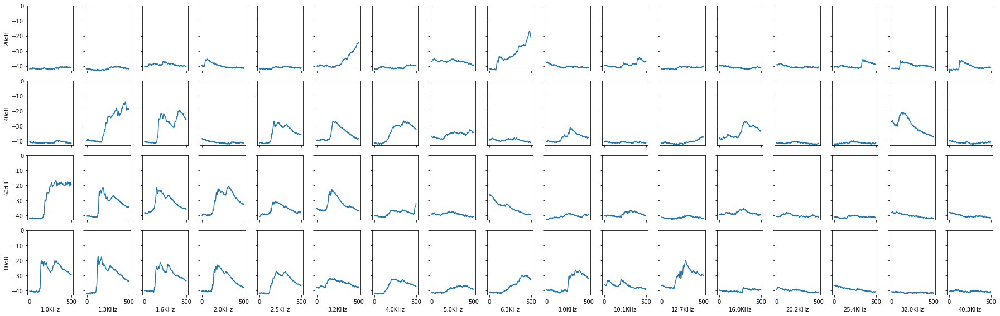

In [16]:
ev = raster_align('20020508', 'mw', '003');

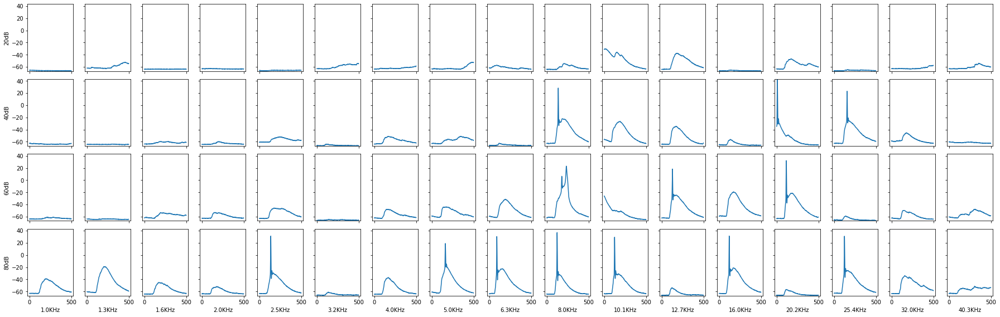

In [17]:
ev = raster_align('20020608', 'mw', '002');

##Spectrograms

In [18]:
def next_power_of_2(x):  
    return 1 if x == 0 else 2**(x - 1).bit_length()


def plot_spectrogram(signal, sf, ax, window_sec=0.1, maxy=10000):
  """Plot spectrogram and return the calculation values"""
  nfft = int(window_sec * sf)
  noverlap = int(nfft * 0.5)  # overlap set to be half of a segment
  nfft_padded = next_power_of_2(nfft)  # pad segment with zeros for making nfft of power of 2 (better performance)
  vmin = 20*np.log10(np.max(signal)) - 90  # hide anything below -90 dBc

  Sxx, f, t, img = ax.specgram(signal, Fs=sf, NFFT=nfft, noverlap=noverlap,
              pad_to=nfft_padded, mode='magnitude', vmin=vmin)
  # plt.colorbar(img, ax=ax)
  ax.set_ylim([0, maxy])
  ax.set_ylabel('Frequency [Hz]')
  ax.set_xlabel('Time [sec]')
  ax.set_title('Spectrogram')

  return Sxx, f, t

##Knudsens's Frog Sample

In [19]:
!wget https://raw.githubusercontent.com/regevti/sensory-systems-workshop/master/Auditory/knudsens_frog.wav

--2021-06-03 12:49:52--  https://raw.githubusercontent.com/regevti/sensory-systems-workshop/master/Auditory/knudsens_frog.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2929740 (2.8M) [audio/wav]
Saving to: ‘knudsens_frog.wav’

knudsens_frog.wav   100%[===================>]   2.79M  --.-KB/s    in 0.09s   

2021-06-03 12:49:53 (32.6 MB/s) - ‘knudsens_frog.wav’ saved [2929740/2929740]



In [20]:
wav_sf, samples = wavfile.read('knudsens_frog.wav')
IPython.display.Audio(samples, rate=wav_sf)

(4097, 599)

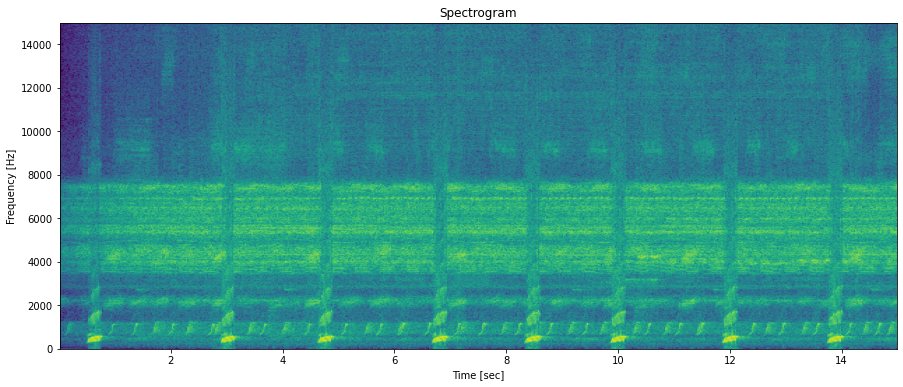

In [21]:
fig, ax = plt.subplots(1,1,figsize=(15,6))
Sxx, f, t = plot_spectrogram(samples, wav_sf, ax, maxy=15000, window_sec=0.05)
Sxx.shape

###Low Pass Filter

In [22]:
def butter_lowpass(lowcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    b, a = butter(order, low, btype='low')
    return b, a


def butter_lowpass_filter(data, lowcut, fs, order=5):
    b, a = butter_lowpass(lowcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

eliminating the crickets and other high-pitched background sounds

In [23]:
lowpass_samples = butter_lowpass_filter(samples, 2600, wav_sf)
IPython.display.Audio(lowpass_samples, rate=wav_sf)

eliminiating the toads

In [24]:
lowpass_samples = butter_lowpass_filter(samples, 1000, wav_sf)
IPython.display.Audio(lowpass_samples, rate=wav_sf)

##Song Stimulus: Jimi Hendrix - Purple Haze

In [25]:
!wget https://raw.githubusercontent.com/regevti/sensory-systems-workshop/master/Auditory/purple_haze.wav

--2021-06-03 12:49:56--  https://raw.githubusercontent.com/regevti/sensory-systems-workshop/master/Auditory/purple_haze.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24804850 (24M) [application/octet-stream]
Saving to: ‘purple_haze.wav’

purple_haze.wav     100%[===================>]  23.66M  75.0MB/s    in 0.3s    

2021-06-03 12:49:58 (75.0 MB/s) - ‘purple_haze.wav’ saved [24804850/24804850]



In [26]:
jimi_sf, jimi_samples = wavfile.read('purple_haze.wav')
IPython.display.Audio(jimi_samples, rate=jimi_sf)

Extracting the first 4 seconds of the song

In [27]:
intro = jimi_samples[:int(4 * jimi_sf)]
IPython.display.Audio(intro, rate=jimi_sf)

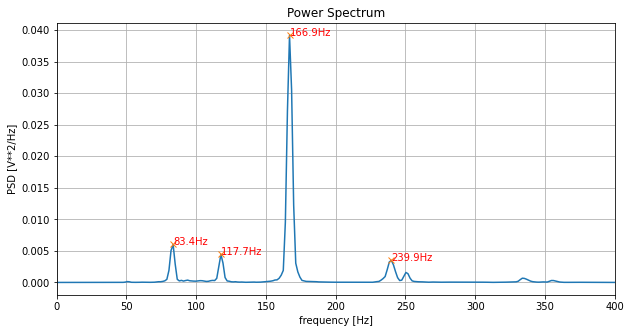

In [28]:
nperseg = int(0.5 * jimi_sf)
noverlap = int(nperseg * 0.5)
nfft = next_power_of_2(nperseg)
f, Pxx_den = welch(intro, jimi_sf, nperseg=nperseg, noverlap=noverlap, nfft=nfft)

peaks, _ = find_peaks(Pxx_den, prominence=0.003, distance=10)

plt.figure(figsize=(10,5))
plt.plot(f, Pxx_den)
plt.plot(f[peaks], Pxx_den[peaks], 'x')
for peak in peaks:
  plt.text(f[peak], Pxx_den[peak], f'{f[peak]:.1f}Hz', fontdict={'color': 'red'})
plt.xlim([0, 400])
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.title('Power Spectrum')
plt.grid()

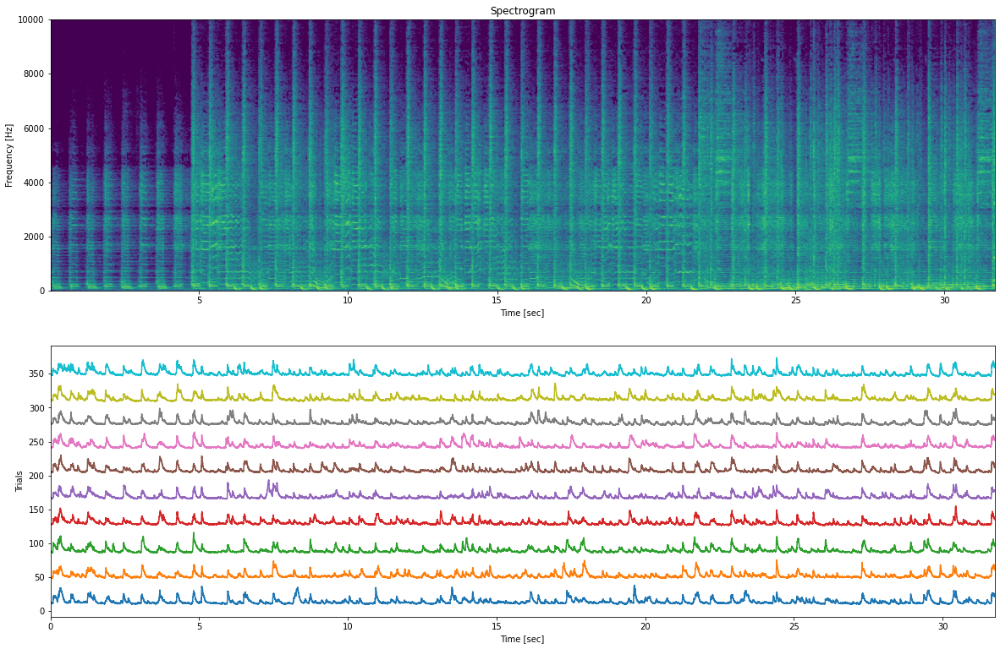

In [31]:
def audio_response(description, wav_samples, wav_sf):
  fig, axes = plt.subplots(2,1,figsize=(20, 13))
  plot_spectrogram(wav_samples, wav_sf, axes[0])

  max_prev_trace = 0
  trigs = trig_df.query(f'description == "{description}"').reset_index(drop=True)
  for i, trig in trigs.iterrows():
    response = records[trig['name']]['trace']
    sf = records[trig['name']]['sf']
    scale = records[trig['name']]['scale']
    ti0 = int(trig.time)  # index of response at stimulus start
    # stop time is dictated by the stimulus duration and offset (both in milliseconds) 
    ti1 = int(ti0 + (trig.duration) * sf / 1000)
    signal = response[ti0:ti1] * scale

    t = np.arange(0, ti1-ti0) / sf
    signal = signal + np.abs(signal.min()) + 10
    axes[1].plot(t, signal + max_prev_trace)
    max_prev_trace = max_prev_trace + signal.max()
    axes[1].autoscale(enable=True, axis='x', tight=True)
    axes[1].set_ylabel('Trials')
    axes[1].set_xlabel('Time [sec]')


audio_response('Jimi Hendrix: purple haze', jimi_samples, jimi_sf)